### Exploracion de Datos

In [1]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install branca

Note: you may need to restart the kernel to use updated packages.


#### Importar Librerias

In [3]:
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import folium
import branca

from sklearn.impute import KNNImputer
from sklearn.preprocessing import LabelEncoder

from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import SelectKBest, f_regression

from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

from sklearn.metrics import mean_squared_error, r2_score

import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_rows', 120)
pd.set_option('display.max_columns', None)

In [4]:
df = pd.read_csv('df.csv.gz')
dflistings = pd.read_csv('dflistings.csv.gz')
#X_train = pd.read_csv('X_train.csv.gz')
#X_test = pd.read_csv('X_test.csv.gz')
#y_train = pd.read_csv('y_train.csv.gz')
#y_test = pd.read_csv('y_test.csv.gz')

In [5]:
df['date'] = pd.to_datetime(df['date'])

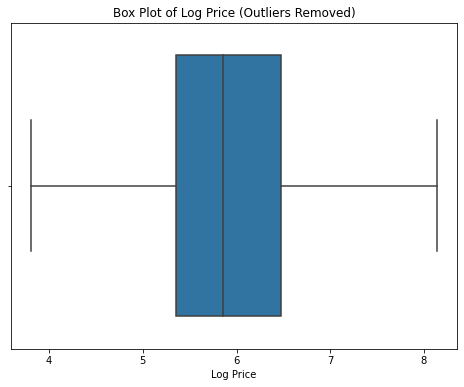

In [6]:
plt.figure(figsize=(8, 6))
sns.boxplot(x=df['log_price'])

plt.xlabel('Log Price')
plt.title('Box Plot of Log Price (Outliers Removed)')

plt.show()

#Se visualiza la distribución de precios sin valores atípicos en la cual se observa que no hay puntos fuera de los 'bigotes', lo que confirma la efectiva eliminación de valores atípicos del análisis de la variable 'log_price'.


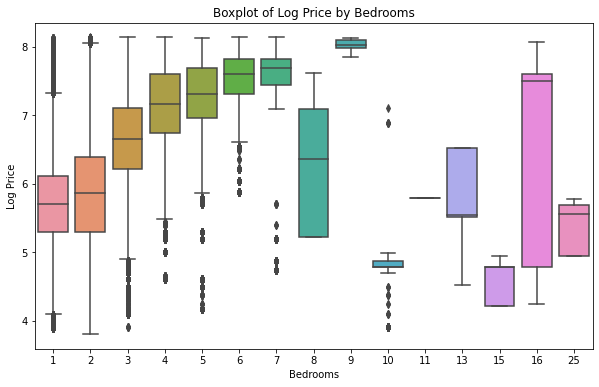

In [7]:
# El gráfico muestra la relación entre el número de dormitorios y el precio de los alojamientos. 
# Se observa que, en general, a medida que aumenta el número de dormitorios, también lo hace la mediana 
# y el rango del Log Price. Hay una variabilidad notable en los precios para alojamientos con un gran número de 
# dormitorios, lo cual se ve reflejado en los rangos intercuartílicos más amplios y la presencia de valores atípicos,
# especialmente en alojamientos con más de 10 dormitorios. 

plt.figure(figsize=(10, 6))

sns.boxplot(x=df['bedrooms'], y=df['log_price'])

plt.title('Boxplot of Log Price by Bedrooms')
plt.xlabel('Bedrooms')
plt.ylabel('Log Price')

plt.show()

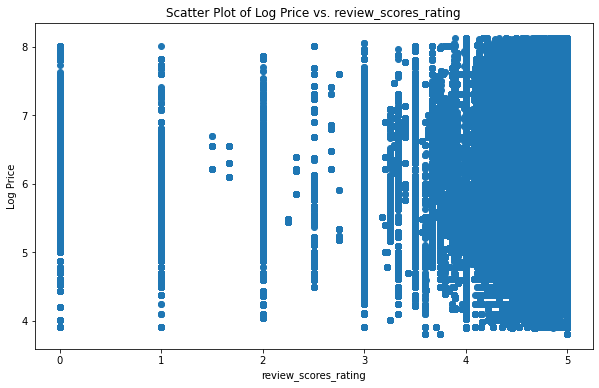

In [8]:
plt.figure(figsize=(10, 6))

plt.scatter(df['review_scores_rating'], df['log_price'])
plt.title('Scatter Plot of Log Price vs. review_scores_rating')
plt.xlabel('review_scores_rating')
plt.ylabel('Log Price')

plt.show()

#Cada punto en el gráfico corresponde a una propiedad individual, con la posición horizontal del punto indicando la puntuación recibida por sus huéspedes y la posición vertical reflejando el precio.
#El gráfico sugiere que las puntuaciones de las reseñas no están fuertemente correlacionadas con los precios, ya que los precios varían significativamente dentro de cada nivel de puntuación y no
#muestran una tendencia clara que indique que las reseñas más altas conducen a precios más altos o viceversa.

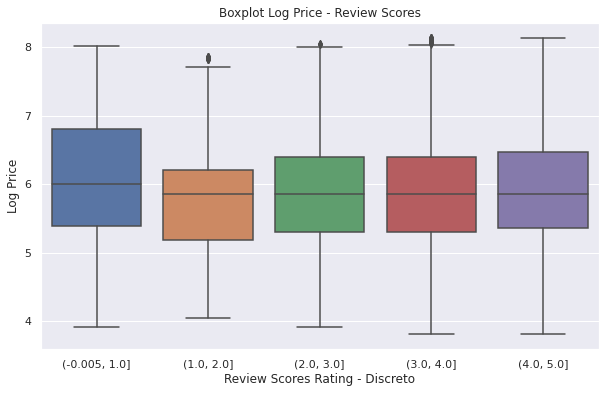

In [29]:
# En este grafico, se verifica que no existe una fuerte relación entre la variable review_scores_rating y log_price.

df['bin'] = pd.cut(df['review_scores_rating'], bins=5) 

plt.figure(figsize=(10, 6))

sns.boxplot(x=df['bin'], y=df['log_price'])

plt.title('Boxplot Log Price - Review Scores')
plt.xlabel('Review Scores Rating - Discreto')
plt.ylabel('Log Price')

plt.show()

In [10]:
heat_data = dflistings[['latitude', 'longitude', 'price']]

heat_data['log_price'] = np.log(heat_data['price'])

# Eliminar filas donde log_price es -inf

heat_data = heat_data[['latitude', 'longitude', 'log_price']].replace(-float('inf'), float('nan')).dropna()

# Calcular los precios log mínimos y máximos para determinar el rango de colores

min_log_price = heat_data['log_price'].min()
max_log_price = heat_data['log_price'].max()

# Crear un mapa centrado alrededor de la latitud y longitud promedio

m = folium.Map(location=[heat_data['latitude'].mean(), heat_data['longitude'].mean()], zoom_start=13)

# Función para obtener el color basado en el precio

def get_color(price):
    if price < min_log_price + (max_log_price - min_log_price) / 3:
        return 'green'
    elif price < min_log_price + (2 * (max_log_price - min_log_price) / 3):
        return 'yellow'
    else:
        return 'red'

# Agregar marcadores al mapa

for index, row in heat_data.iterrows():
    color = get_color(row['log_price'])
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6
    ).add_to(m)

# Crear un colormap lineal basado en el rango calculado de precios log

colormap = branca.colormap.LinearColormap(
    colors=['green', 'yellow', 'red'],
    index=[min_log_price, min_log_price + (max_log_price - min_log_price) / 3, max_log_price],
    vmin=min_log_price,
    vmax=max_log_price
)
colormap.caption = 'Log Price'
m.add_child(colormap)

# Mostrar el mapa
display(m)

#El mapa muestra una distribución geográfica de precios para los diferentes alojamientos. Los colores de los marcadores representan diferentes rangos de precios,
#donde verde indica los precios más bajos, amarillo los precios medios y rojo los precios más altos.

In [11]:
df.groupby('neighbourhood_cleansed')['log_price'].describe().sort_values(by='mean', ascending=False).head(50)

,count,mean,std,min,25%,50%,75%,max
neighbourhood_cleansed,,,,,,,,
Joá,18362.0,6.489287,0.908036,4.787492,5.703782,6.329721,7.224753,8.131531
São Conrado,60197.0,6.407082,0.902839,4.369448,5.703782,6.396930,7.090077,8.126814
Leblon,483583.0,6.394886,0.689499,3.988984,5.934894,6.380123,6.856462,8.131825
Lagoa,82633.0,6.329850,0.850846,3.912023,5.828946,6.309918,6.888572,8.101678
Ipanema,957843.0,6.294444,0.724321,3.912023,5.826000,6.214608,6.777647,8.135933
Barra da Tijuca,976318.0,6.238820,0.759832,3.891820,5.703782,6.194405,6.745236,8.136226
Itanhangá,39242.0,6.122710,1.065593,3.912023,5.247024,5.991465,7.117206,8.109225
Gávea,61128.0,6.082612,0.833658,3.951244,5.501258,6.040255,6.684612,8.074960
Recreio dos Bandeirantes,471911.0,6.081659,0.798769,3.891820,5.521461,6.016157,6.620073,8.128585


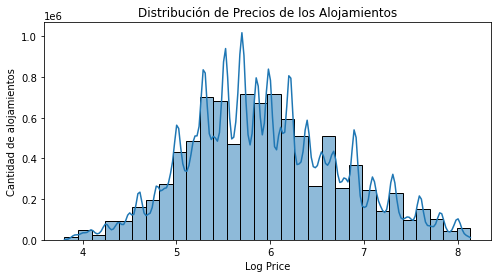

In [12]:
#Se visualiza la relación entre los diferentes niveles de precios y la cantidad de alojamientos.

plt.figure(figsize=(8, 4))
sns.histplot(df['log_price'], bins=30, kde=True)
plt.title('Distribución de Precios de los Alojamientos')
plt.xlabel('Log Price')
plt.ylabel('Cantidad de alojamientos')
plt.show()

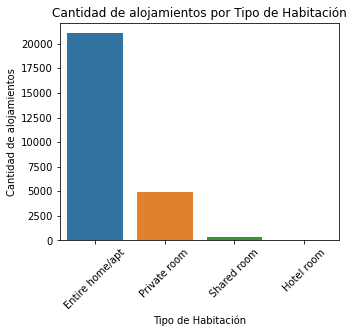

In [13]:
#Cantidad de alojamientos por tipo de Habitación

plt.figure(figsize=(5, 4))
sns.countplot(data=dflistings, x='room_type')
plt.title('Cantidad de alojamientos por Tipo de Habitación')
plt.xlabel('Tipo de Habitación')
plt.ylabel('Cantidad de alojamientos')
plt.xticks(rotation=45)
plt.show()

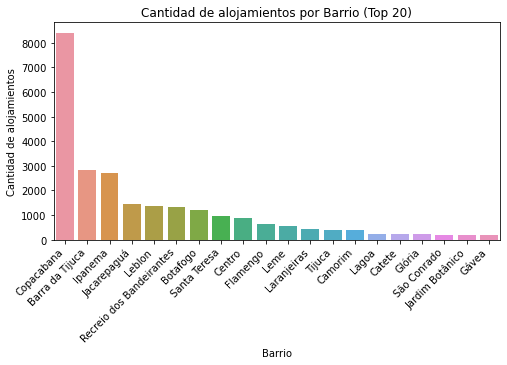

In [14]:
#Cantidad de alojamientos por barrio

plt.figure(figsize=(8, 4))
neighbourhood_counts = dflistings['neighbourhood_cleansed'].value_counts()[:20]  # Top 20 neighbourhoods
sns.barplot(x=neighbourhood_counts.index, y=neighbourhood_counts.values)
plt.title('Cantidad de alojamientos por Barrio (Top 20)')
plt.xlabel('Barrio')
plt.ylabel('Cantidad de alojamientos')
plt.xticks(rotation=45, horizontalalignment='right')
plt.show()

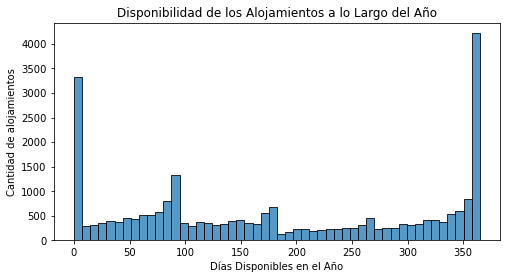

In [15]:
#Relación entre la cantidad de días disponibles con la cantidad de alojamientos.

plt.figure(figsize=(8, 4))
sns.histplot(dflistings['availability_365'], bins=50, kde=False)
plt.title('Disponibilidad de los Alojamientos a lo Largo del Año')
plt.xlabel('Días Disponibles en el Año')
plt.ylabel('Cantidad de alojamientos')
plt.show()

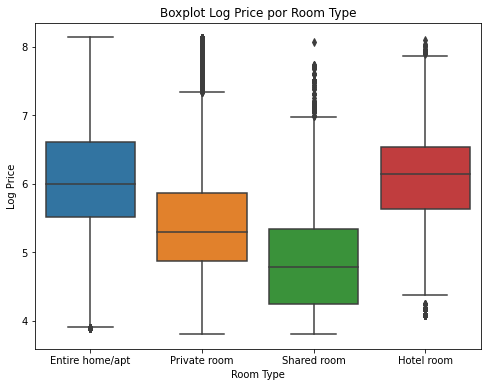

In [16]:
#En el boxplot anterior se puede observar que el logaritmo del precio se compara entre diferentes tipos de habitación. 
#Donde 'Entire home/apt' muestra una mayor mediana de precios, seguido por 'Private room' y 'Hotel room', con 'Shared room' teniendo la mediana más baja. 

plt.figure(figsize=(8, 6))

sns.boxplot(data=df, x='room_type', y='log_price')

plt.title('Boxplot Log Price por Room Type')
plt.xlabel('Room Type')
plt.ylabel('Log Price')

plt.show()

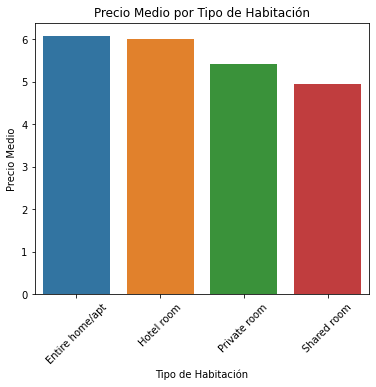

In [17]:
#Se calcula y visualiza el precio medio por tipo de habitación

mean_prices = df.groupby('room_type')['log_price'].mean().reset_index()

plt.figure(figsize=(6, 5))
sns.barplot(data=mean_prices, x='room_type', y='log_price')
plt.xticks(rotation=45)
plt.xlabel('Tipo de Habitación')
plt.ylabel('Precio Medio')
plt.title('Precio Medio por Tipo de Habitación')
plt.show()

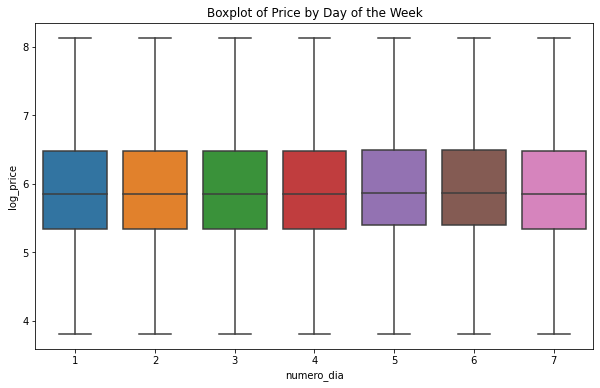

In [18]:
#Se visualiza la distribución de precios de los alojamientos por cada día de la semana. No se observan variaciones significativas en la mediana de los precios entre los días, por lo que se puede concluir que los precios no presentan mayor variaciones en dependencia del día de la semana.

plt.figure(figsize=(10, 6))
sns.boxplot(x='numero_dia', y='log_price', data=df)
plt.title('Boxplot of Price by Day of the Week')
plt.show()

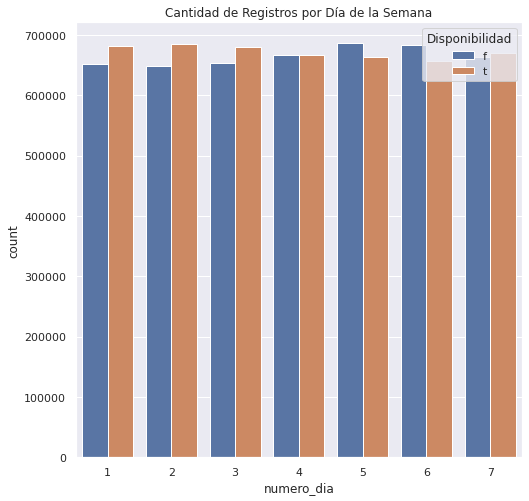

In [19]:
#El gráfico de barras muestra la cantidad de registros de alojamientos por cada día de la semana (lunes = 1, Martes = 2, etc.), diferenciando entre aquellos que están disponibles ('t') y no disponibles ('f').
#Tampoco se observa un comportamiento diferencial entre los días de la semana.

sns.set(style="darkgrid")

plt.figure(figsize=(8, 8))

sns.countplot(x="numero_dia", hue="available", data=df);

plt.legend(title='Disponibilidad', loc='upper right')

plt.title('Cantidad de Registros por Día de la Semana')

plt.show()

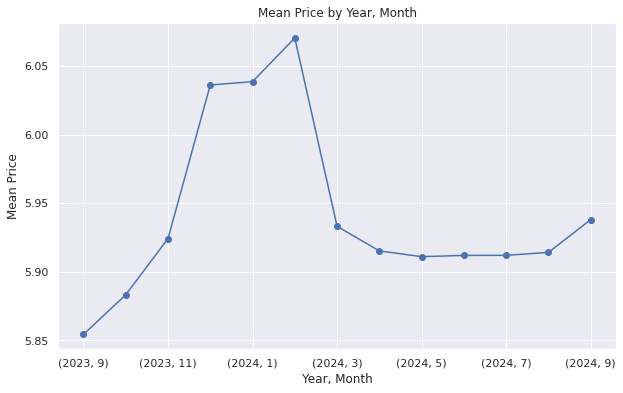

In [20]:
#Se grafica el comportamiento del precio medio en función del mes para el período Septiembre 2023 a Septiembre 2024.
#Se muestra un crecimiento en los precios cuando el año va alcanzando sus últimos meses, tendencia que se mantiene hasta Febrero
#inclusive, para posteriormente comenzar a descender el nivel de precios hasta alcanzar un equilibrio para el resto del año.


mean_price_by_month_year = df.groupby(['year', 'month'])['log_price'].mean()

plt.figure(figsize=(10, 6))
mean_price_by_month_year.plot(marker='o')

plt.xlabel('Year, Month')
plt.ylabel('Mean Price')
plt.title('Mean Price by Year, Month')

plt.show()

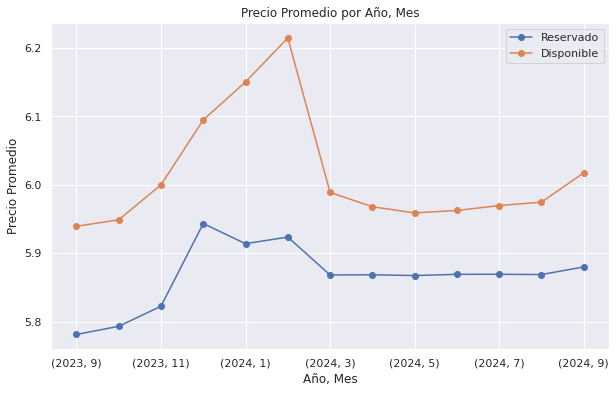

In [21]:
#El gráfico de líneas representa la variación del precio promedio de alojamientos a lo largo del tiempo, diferenciando entre aquellos que han sido reservados y los que están disponibles.
#Los datos reflejan que en los últimos meses del año los precios son superiores que a los restos del año.


mean_price_by_month_year_avail = df.groupby(['year', 'month', 'available'])['log_price'].mean().unstack()

mean_price_by_month_year_avail = mean_price_by_month_year_avail.rename(columns={'t': 'Disponible', 'f': 'Reservado'})

plt.figure(figsize=(10, 6))

for avail, data in mean_price_by_month_year_avail.items():
    data.plot(marker='o', label=f'{avail}')

plt.xlabel('Año, Mes')
plt.ylabel('Precio Promedio')
plt.title('Precio Promedio por Año, Mes')

plt.legend()

plt.show()



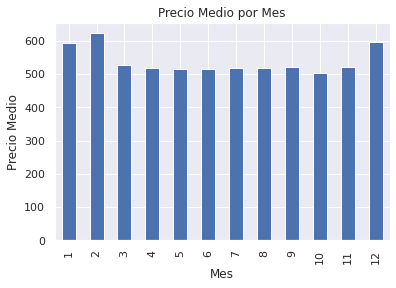

In [22]:
#Se observa el mismo comportamiento que el mencionado anteriormente, donde los meses de verano presentan mayores precios en los alojamientos.

df.groupby('month')['price'].mean().plot(kind='bar')
plt.xlabel('Mes')
plt.ylabel('Precio Medio')
plt.title('Precio Medio por Mes')
plt.show()

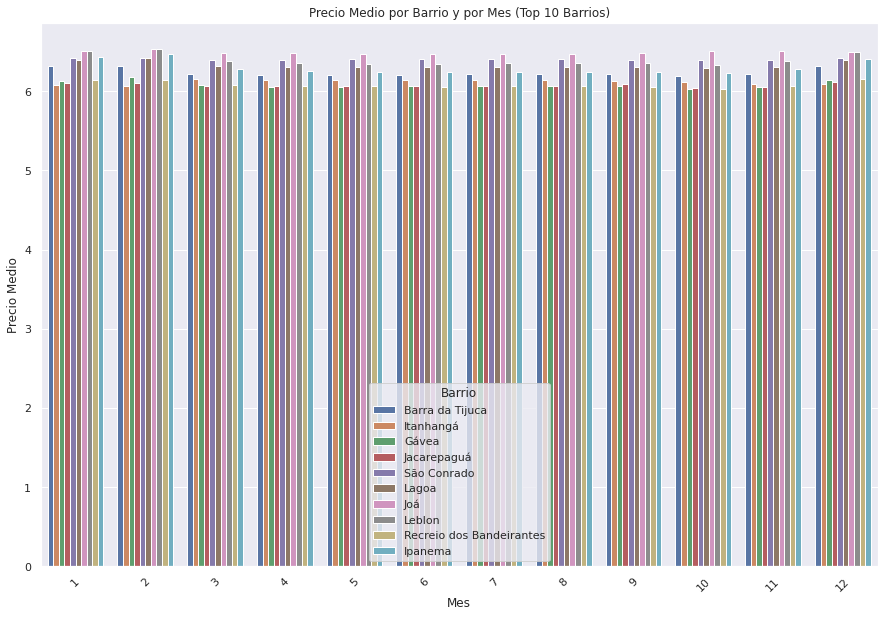

In [23]:

mean_price_by_neighbourhood = df.groupby('neighbourhood_cleansed')['log_price'].mean().sort_values(ascending=False)

top_neighbourhoods = mean_price_by_neighbourhood.head(10).index

df_top_neighbourhoods = df[df['neighbourhood_cleansed'].isin(top_neighbourhoods)]

price_means = df_top_neighbourhoods.groupby(['neighbourhood_cleansed', 'month'])['log_price'].mean().reset_index()

months_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
price_means['month_name'] = pd.Categorical(price_means['month'], categories=months_order, ordered=True)
price_means.sort_values(by='month', inplace=True)

plt.figure(figsize=(15, 10))
sns.barplot(x='month', y='log_price', hue='neighbourhood_cleansed', data=price_means)

plt.title('Precio Medio por Barrio y por Mes (Top 10 Barrios)')
plt.xlabel('Mes')
plt.ylabel('Precio Medio')
plt.xticks(rotation=45)
plt.legend(title='Barrio')

plt.show()

#Se grafica la  misma información (precio medio por mes) pero esta vez detallado por los 10 barrios con mayor precio promedio. En esta oportunidad además de mantener el comporamiento observado anterioramente,
#se muestra una clara diferencia entre los precios de los barrios y la misma se mantiene durante todo el año.

In [24]:
df['year_month'] = df['date'].dt.to_period("M")

grouped_data = df.groupby(['year_month', 'neighbourhood_cleansed'], as_index=False)['log_price'].mean()

grouped_data['year_month'] = grouped_data['year_month'].astype(str)


fig = px.line(grouped_data, x='year_month', y='log_price', color='neighbourhood_cleansed',
              labels={'log_price': 'Average Price', 'year_month': 'Year and Month'},
              title='Average Price Trend by Neighborhood')

fig.update_layout(width=800, height=500, margin=dict(l=50, r=50, t=50, b=50))

fig.show()

#Se grafica el comportamiento del precio promedio de los alojamientos en cada barrio a lo largo del período Septiembre 2023 a 
#Septiembre 2024. En todos los casos se observa un claro aumento de precios en el período de Noviembre a Febrero.

In [25]:
df['numero_dia'] = df['date'].dt.dayofweek + 1  # Suma 1 para que el lunes sea 1, martes 2, etc.

# Elimina la columna 'bathrooms_text'

df.drop(columns=['date'], inplace=True)

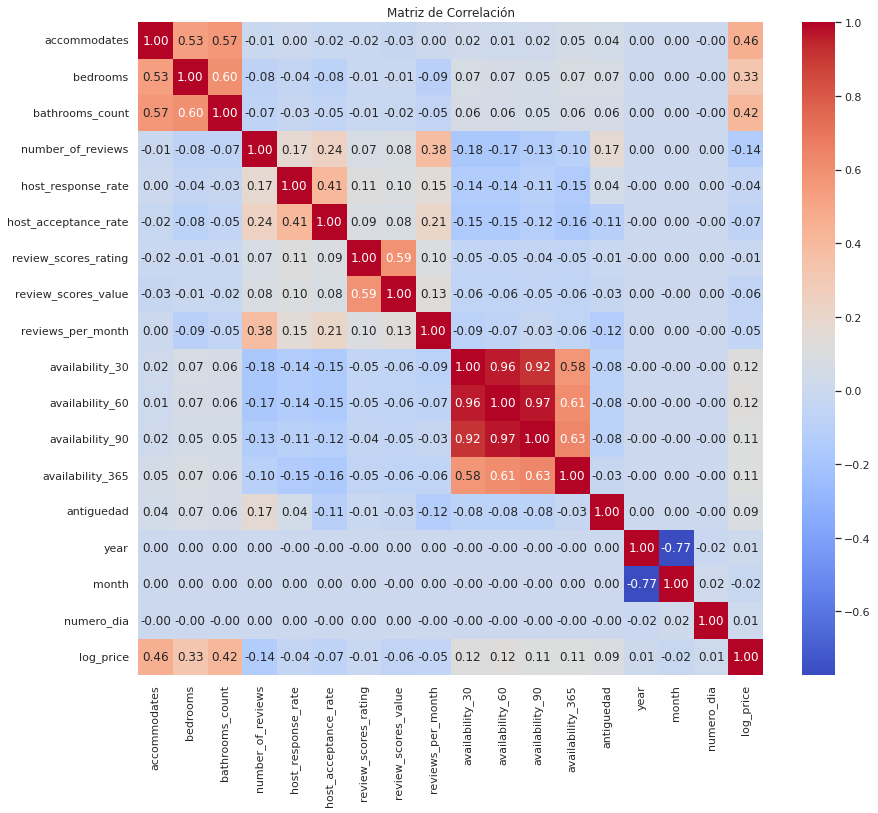

In [26]:
selected_columns = df[['accommodates','bedrooms', 'bathrooms_count' ,'number_of_reviews','host_response_rate', 'host_acceptance_rate',
                               'review_scores_rating', 'review_scores_value','reviews_per_month',  'availability_30', 'availability_60','availability_90', 'availability_365',
                              'antiguedad','year', 'month', 'numero_dia','log_price']]

correlation_matrix = selected_columns.corr()

plt.figure(figsize=(14, 12))
plt.title('Matriz de Correlación')
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

#A partir de los datos visibles en el gráfico:
#accommodates, bedrooms, y bathrooms_count muestran una correlación positiva con log_price, lo que sugiere que a medida que aumenta el número de personas que la propiedad puede alojar, o el número de dormitorios y baños, también tiende a aumentar el precio.
#Esto es consistente con la intuición de que propiedades más grandes o que pueden acomodar a más personas generalmente tienen un precio más elevado.